# Importations et fonctions

## Importations

In [53]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import pickle, math, datetime, scipy
import matplotlib.pyplot as plt
from sklearn.model_selection import StratifiedShuffleSplit
from tree import ConfusionMatrix
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
import tree
from sklearn import metrics

import os, sys, re, random, subprocess

## Fonctions générales

In [54]:
# We want to verify that the dates of first observation are identical
def displayFirstDate(data):
    """
    Allow to display the first date of observations
    """
    dateList = []
    for idPot in data['idPot'].unique():
        dateList.append(data[data['idPot'] == idPot]['Date'].min())

    dateList = sorted(set(dateList))
    for e in dateList:
        print(e)
        

def oneGrowthGraph(data, name):
    """
    Display the plot of indicated accession.
    """
    
    acc = name

    fig = plt.figure(figsize=(15,15))
    ax = fig.add_axes([0.1,0.1,0.8,0.8])

    d = data[(data['Accession'] == acc)][['Surface_projetee','Jours', 'idPot', 'Condition']]
    d.set_index('Jours', inplace=True)
    idPlot = list(d['idPot'].unique())
    color = ['red','black','blue']

    for i in range(len(idPlot)):
        if d[d['idPot'] == idPlot[i]]['Condition'].iloc[0] == 'WW':
            color = 'blue'
        elif d[d['idPot'] == idPlot[i]]['Condition'].iloc[0] == 'MWD':
            color = 'purple'
        else:
            color = 'red'
            
        ax.plot(d[d['idPot'] == idPlot[i]]['Surface_projetee'], color=color, marker='o')


    WW = mpatches.Patch(color="blue", label='WW')
    MWD = mpatches.Patch(color="purple", label='MWD')
    SWD = mpatches.Patch(color="red", label='SWD')
    #ax.legend(handles=[WW,MWD,SWD], prop={'size': 15})
    ax.set_ylabel("Surface de la rosette projetée (mm²)")
    ax.set_xlabel("Nombre de jours")
        
def displaysAllPlots(data):
    genotypes = list(data['Accession'].unique())
    nbLine = len(genotypes)//3
    if len(genotypes)%3 != 0:
        nbLine += 1
    print(nbLine)
    fig, axes = plt.subplots(nbLine,3, figsize=(50,15*nbLine))
    axes = axes.flatten()
    
    # Prepare legend label
    WW = mpatches.Patch(color="blue", label='WW')
    MWD = mpatches.Patch(color="purple", label='MWD')
    SWD = mpatches.Patch(color="red", label='SWD')
    
    for g in range(len(genotypes)):
        if "TimeSerie" in data.columns:
            d = data[(data['Accession'] == genotypes[g])][['idPot' ,'Condition','TimeSerie']]
        else:
            d = data[(data['Accession'] == genotypes[g])][['Surface_projetee','Jours', 'idPot', 'Condition']]
            d.set_index('Jours', inplace=True)
        
        idPot = list(d['idPot'].unique())
        for i in range(len(idPot)):
            if d[d['idPot'] == idPot[i]]['Condition'].iloc[0] == 'WW':
                color = 'blue'
            elif d[d['idPot'] == idPot[i]]['Condition'].iloc[0] == 'MWD':
                color = 'purple'
            else:
                color = 'red'
            if "TimeSerie" in data.columns:
                axes[g].plot(list(data[data_formated['idPot'] == idPot[i]]['TimeSerie'])[0], color=color, marker='o')
            else:
                axes[g].plot(d[d['idPot'] == idPot[i]]['Surface_projetee'], color=color, marker='o')
                
        axes[g].set_title("{}".format(genotypes[g]), fontsize=30)
        axes[g].xaxis.set_tick_params(labelsize=20)
        axes[g].yaxis.set_tick_params(labelsize=20)
        axes[g].set_ylim([0,8000])
        axes[g].set_xlim([0,80])
        axes[g].legend(handles=[WW,MWD,SWD], prop={'size': 20})

def filterAccession(df, listacc,keep=True):
    if keep:
        return df[df['Accession'].isin(listacc)]
    else:
        return df[~df['Accession'].isin(listacc)]
    
def reduceTree(treeFile, groupFile, data2format, level):
    """
    Permet de réduire l'arbre de décision généré par l'algorithme de recherche de shapelet de Mueen.
    """
    # Ouverture du fichier des groupes
    with open(groupFile, "r") as f:
        file = f.readlines()
        file = [e.strip() for e in file]
        file = [e for e in file if "#" not in e]
    
    dictNode = {}
    l=0
    while l < len(file)-1:
        dictNode[file[l]] = file[l+1].split(",")
        #print(dictNode[file[l]])
        dictNode[file[l]] = [int(x) for x in dictNode[file[l]] if x]
        l+=2
    
    nbLevel = math.ceil(math.log2(max([int(x) for x in dictNode.keys()])))
    # Vérification du niveau max de l'arbre
    if level > nbLevel:
        print("L'arbre n'a pas suffisamment de niveau.")
        sys.exit(0)
        
    # Ouverture du fichier de l'arbre
    with open(treeFile, "r") as f:
        file = f.readlines()
        file = [e.strip() for e in file]
    
    # Affichage avant modifications
    maxNode = 2**int(level)
    
    # On parcourt l'arbre par étage en partant des feuilles
    while nbLevel > level:
        # Liste des noeuds du niveau nbLevel
        listeCurrentNode = list(range(2**(nbLevel-1),2**nbLevel))
        #print(listeCurrentNode)
        i=0
        # On parcourt le fichier (tous les noeuds de l'arbre)
        while i < len(file):
            #print("Cherche premier fils")
            if file[i+1] == "0":
                # Si le noeuds fait partie des feuilles du dernier niveau
                if int(file[i]) in listeCurrentNode:
                    #print("Trouve premier fils {}".format(file[i]))
                    # Récupération de l'identité du noeud père
                    if int(file[i])%2==0:
                        father = int(int(file[i])/2)
                        left = True
                    else:
                        father = int((int(file[i]) - 1)/2)
                        left = False
                
                    # Recherche du père dans le fichier
                    # Une fois fait, on élimine les deux feuilles fils et on transforme
                    # le père en feuille comme appartenant à la classe majoritaire
                    # avec les fils réunis.
                    j=0
                    while j < len(file):
                        #print("Cherche père")
                        if file[j] == str(father):
                            #print("Trouve le père {}".format(file[j]))
                            # On cherche l'autre fils du noeud père
                            k=0
                            while k < len(file):
                                #print("Cherche l'autre fils")
                                if file[k+1] == "0":
                                    # Si le noeud courant est gauche quand on cherche gauche ou droit quand on cherche droit
                                    if (file[k] == str(father*2+1) and left) or (file[k] == str(father*2) and not left):
                                        #print("Trouve l'autre fils {}".format(file[k]))
                                        # Comparer le contenu de la feuille gauche avec la feuille droite
                                        #### Récupération des clés des deux fils
                                        index = dictNode[file[i]] + dictNode[file[k]]
                                        index = list(set(index))
                                            
                                        #### Récupération de la classe majoritaire
                                        classMax = str(int(data2format.iloc[index].groupby("Classe").count()["id"].idxmax()))
                                        
                                            
                                        # Ecriture de la classe max dans le père
                                        file[j+1] = "0"
                                        file[j+2] = classMax
                                        file[j+3] = 's'
                                        
                                        # Supprimer les deux fils dans le fichier de sous-groupes
                                        del dictNode[file[i]]
                                        del dictNode[file[k]]
                                        
                                        # Supprimer les deux fils
                                        file[i] = 's'
                                        file[i+1] = 's'
                                        file[i+2] = 's'
                                        file[k] = 's'
                                        file[k+1] = 's'
                                        file[k+2] = 's'
                                        
                                        # Suppression des lignes qui ont été marquées 's'
                                        while 's' in file:
                                            file.remove("s")
                                        
                                        # Pour sortir des boucles "recherche fils" et "recherche père"
                                        # On se retouve alors dans la boucle recherche feuilles contenu dans le dernier niveau
                                        k = len(file)
                                        j = len(file)-2
                                        i = -3
                                    k+=3
                                else:
                                    k+=4

                        if file[j+1] == "0":
                            j+=3
                        else:
                            j+=4
                i+=3
            else:
                i+=4
        nbLevel-=1
        
    # Ecriture de l'arbre
    with open(treeFile, "w") as f:
        for i,r in enumerate(file):
            if i == (len(file)-1):
                f.write(r)
            else:
                f.write(r+"\n")
                    
    # Ecriture du fichier des sous-groupes
    with open(groupFile, 'w') as f:
        for k,v in dictNode.items():
            f.write("#\n")
            f.write(k+"\n")
            v = [str(x) for x in v]
            f.write(",".join(v)+"\n")
#reduceTree("temp/train3_tree", "temp/sousGroupes_3", data2format, 2)

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')
    
    plt.figure(figsize=(5,5))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
def show_values(pc, fmt="%.2f", **kw):
    '''
    Heatmap with text in each cell with matplotlib's pyplot
    Source: https://stackoverflow.com/a/25074150/395857 
    By HYRY
    '''
    pc.update_scalarmappable()
    #print(pc)
    #print(dir(pc))
    #ax = pc.get_axes()
    ax = pc.axes
    for p, color, value in zip(pc.get_paths(), pc.get_facecolors(), pc.get_array()):
        x, y = p.vertices[:-2, :].mean(0)
        if np.all(color[:3] > 0.5):
            color = (0.0, 0.0, 0.0)
        else:
            color = (1.0, 1.0, 1.0)
        ax.text(x, y, fmt % value, ha="center", va="center", color=color, **kw)


def cm2inch(*tupl):
    '''
    Specify figure size in centimeter in matplotlib
    Source: https://stackoverflow.com/a/22787457/395857
    By gns-ank
    '''
    inch = 2.54
    if type(tupl[0]) == tuple:
        return tuple(i/inch for i in tupl[0])
    else:
        return tuple(i/inch for i in tupl)
    
def heatmap(AUC, title, xlabel, ylabel, xticklabels, yticklabels, figure_width=40, figure_height=20, correct_orientation=False, cmap='RdBu'):
    '''
    Inspired by:
    - https://stackoverflow.com/a/16124677/395857 
    - https://stackoverflow.com/a/25074150/395857
    '''

    # Plot it out
    fig, ax = plt.subplots()    
    c = ax.pcolor(AUC, edgecolors='k', linestyle= 'dashed', linewidths=0.2, cmap='RdBu', vmin=0.0, vmax=1.0)
    #c = ax.pcolor(AUC, edgecolors='k', linestyle= 'dashed', linewidths=0.2, cmap=cmap)

    # put the major ticks at the middle of each cell
    ax.set_yticks(np.arange(AUC.shape[0]) + 0.5, minor=False)
    ax.set_xticks(np.arange(AUC.shape[1]) + 0.5, minor=False)

    # set tick labels
    #ax.set_xticklabels(np.arange(1,AUC.shape[1]+1), minor=False)
    ax.set_xticklabels(xticklabels, minor=False)
    ax.set_yticklabels(yticklabels, minor=False)

    # set title and x/y labels
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)      

    # Remove last blank column
    plt.xlim( (0, AUC.shape[1]) )

    # Turn off all the ticks
    ax = plt.gca()    
    for t in ax.xaxis.get_major_ticks():
        t.tick1On = False
        t.tick2On = False
    for t in ax.yaxis.get_major_ticks():
        t.tick1On = False
        t.tick2On = False

    # Add color bar
    plt.colorbar(c)

    # Add text in each cell 
    show_values(c)

    # Proper orientation (origin at the top left instead of bottom left)
    if correct_orientation:
        ax.invert_yaxis()
        ax.xaxis.tick_top()       

    # resize 
    fig = plt.gcf()
    #fig.set_size_inches(cm2inch(40, 20))
    #fig.set_size_inches(cm2inch(40*4, 20*4))
    fig.set_size_inches(cm2inch(figure_width, figure_height))



def plot_classification_report(classification_report, title='Rapport de classification', cmap='RdBu'):
    '''
    Plot scikit-learn classification report.
    Extension based on https://stackoverflow.com/a/31689645/395857 
    '''
    lines = classification_report.split('\n')

    classes = []
    plotMat = []
    support = []
    class_names = []
    for line in lines[2 : (len(lines) - 2)]:
        t = line.strip().split()
        if len(t) < 2: continue
        classes.append(t[0])
        v = [float(x) for x in t[1: len(t) - 1]]
        support.append(int(t[-1]))
        class_names.append(t[0])
        #print(v)
        plotMat.append(v)

    #print('plotMat: {0}'.format(plotMat))
    #print('support: {0}'.format(support))

    xlabel = ''
    ylabel = 'Classes'
    xticklabels = ['Précision', 'Rappel', 'Mesure F1']
    yticklabels = ['{0} ({1})'.format(class_names[idx], sup) for idx, sup  in enumerate(support)]
    figure_width = 25
    figure_height = len(class_names) + 7
    correct_orientation = False
    heatmap(np.array(plotMat), title, xlabel, ylabel, xticklabels, yticklabels, figure_width, figure_height, correct_orientation, cmap=cmap)
    
# Utility function to report best scores
def report(results, n_top=3):
    for i in range(1, n_top + 1):
        candidates = np.flatnonzero(results['rank_test_score'] == i)
        for candidate in candidates:
            print("Model with rank: {0}".format(i))
            print("Mean validation score: {0:.3f} (std: {1:.3f})".format(
                  results['mean_test_score'][candidate],
                  results['std_test_score'][candidate]))
            print("Parameters: {0}".format(results['params'][candidate]))
            print("")
            
def displayResults(data, instance, idPotIndex, results):
    mpl.style.use("seaborn")
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_axes([0.2,0.2,0.8,0.8])
    
    for i, idPot in enumerate(idPotIndex[instance][1]):
        row = data[data["idPot"] == idPot]
        
        if row["Condition"].values[0] == "WW":
            m = "o"
        elif row["Condition"].values[0] == "MWD":
            m = "v"
        else:
            m = "x"
            
        if results[instance][0][i] == results[instance][1][i]:
            ax.plot(row["TimeSerie"].values[0], label="{} {} {}".format(idPot, row["Accession"].values[0], row["Condition"].values[0]), linestyle="-", marker=m)
        else:
            ax.plot(row["TimeSerie"].values[0], label="{} {} {} classé {}".format(idPot, row["Accession"].values[0], row["Condition"].values[0], dictOptions[FORMAT_CLASSE][int(results[instance][1][i])]), linestyle=":", marker=m)
        
        
        
        
    ax.legend()
    
def watchResults(results):
    mpl.style.use("default")
    
    for i, result in enumerate(results):
        print("Accuracy Cross validation => {}".format(metrics.accuracy_score(result[0], result[1])))
        plot_classification_report(metrics.classification_report(result[0], result[1], target_names=classNames), title="Classification report {}".format(i))

        # Compute confusion matrix
        cnf_matrix = metrics.confusion_matrix(result[0], result[1], labels=list(set(result[0])))
        np.set_printoptions(precision=2)

        plot_confusion_matrix(cnf_matrix, classes=classNames, title='Confusion matrix {}'.format(i))
        
def show_values_cross(pc, std, **kw):
    '''
    Heatmap with text in each cell with matplotlib's pyplot
    Source: https://stackoverflow.com/a/25074150/395857 
    By HYRY
    '''
    pc.update_scalarmappable()
    #print(pc)
    #print(dir(pc))
    #ax = pc.get_axes()
    
    ax = pc.axes
    i = 0
    for p, color, value in zip(pc.get_paths(), pc.get_facecolors(), pc.get_array()):
        x, y = p.vertices[:-2, :].mean(0)
        if np.all(color[:3] > 0.5):
            color = (0.0, 0.0, 0.0)
        else:
            color = (1.0, 1.0, 1.0)
        complete_value = str(value)+" ({})".format(std[i])
        ax.text(x, y, complete_value, ha="center", va="center", color=color, **kw)
        i+=1
    
def heatmapCrossValid(AUC, std, nameFig, title, xlabel, ylabel, xticklabels, yticklabels, figure_width=40, figure_height=20, correct_orientation=False, cmap='RdBu'):
    '''
    Inspired by:
    - https://stackoverflow.com/a/16124677/395857 
    - https://stackoverflow.com/a/25074150/395857
    '''

    # Plot it out
    fig, ax = plt.subplots()    
    c = ax.pcolor(AUC, edgecolors='k', linestyle= 'dashed', linewidths=0.2, cmap='RdBu', vmin=0.0, vmax=1.0)
    #c = ax.pcolor(AUC, edgecolors='k', linestyle= 'dashed', linewidths=0.2, cmap=cmap)
    
    # put the major ticks at the middle of each cell
    ax.set_yticks(np.arange(AUC.shape[0]) + 0.5, minor=False)
    ax.set_xticks(np.arange(AUC.shape[1]) + 0.5, minor=False)

    # set tick labels
    #ax.set_xticklabels(np.arange(1,AUC.shape[1]+1), minor=False)
    ax.set_xticklabels(xticklabels, minor=False)
    ax.set_yticklabels(yticklabels, minor=False)

    # set title and x/y labels
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)      

    # Remove last blank column
    plt.xlim( (0, AUC.shape[1]) )

    # Turn off all the ticks
    ax = plt.gca()    
    for t in ax.xaxis.get_major_ticks():
        t.tick1On = False
        t.tick2On = False
    for t in ax.yaxis.get_major_ticks():
        t.tick1On = False
        t.tick2On = False

    # Add color bar
    plt.colorbar(c)

    # Add text in each cell 
    show_values_cross(c, std)

    # Proper orientation (origin at the top left instead of bottom left)
    if correct_orientation:
        ax.invert_yaxis()
        ax.xaxis.tick_top()       
    
    # resize 
    fig = plt.gcf()
    #fig.set_size_inches(cm2inch(40, 20))
    #fig.set_size_inches(cm2inch(40*4, 20*4))
    fig.set_size_inches(cm2inch(figure_width, figure_height))
    
    fig.savefig(nameFig)
    
def displayClassificationReport(results, classes, nameFig):
    precisions = []
    rappels = []
    mesures_f1 = []
    exactitudes = []
    for result in results:
        precisions.append(metrics.precision_score(result[0], result[1], average=None).tolist())
        rappels.append(metrics.recall_score(result[0], result[1], average=None).tolist())
        mesures_f1.append(metrics.f1_score(result[0], result[1], average=None).tolist())
        exactitudes.append(metrics.accuracy_score(result[0], result[1]).tolist())

    precisions = np.array(precisions)
    rappels = np.array(rappels)
    mesures_f1 = np.array(mesures_f1)
    exactitudes = np.array(exactitudes)
    
    mean_exactitudes = exactitudes.mean(axis=0).tolist()
    std_exactitudes = exactitudes.std(axis=0).tolist()
    
    print("Exactitude : {} ({})".format(round(mean_exactitudes, 2), round(std_exactitudes, 2)))

    mean_precisions = precisions.mean(axis=0).tolist()
    std_precisions = precisions.std(axis=0).tolist()

    mean_rappels = rappels.mean(axis=0).tolist()
    std_rappels = rappels.std(axis=0).tolist()

    mean_mesures_f1 = mesures_f1.mean(axis=0).tolist()
    std_mesures_f1 = mesures_f1.std(axis=0).tolist()

    plotMat = []
    stdMat = []
    for cl in range(len(classes)):
        plotMat.append([])
        stdMat.append([])
        plotMat[cl].append(round(mean_precisions[cl], 2))
        plotMat[cl].append(round(mean_rappels[cl], 2))
        plotMat[cl].append(round(mean_mesures_f1[cl], 2))
        stdMat[cl].append(round(std_precisions[cl], 2))
        stdMat[cl].append(round(std_rappels[cl], 2))
        stdMat[cl].append(round(std_mesures_f1[cl], 2))

    title = "Exactitude : {} ({})".format(round(mean_exactitudes, 2), round(std_exactitudes, 2))
    cmap='RdBu'
    xlabel = ''
    ylabel = 'Classes'
    xticklabels = ['Précision', 'Rappel', 'Mesure-F1']
    yticklabels = classes
    figure_width = 25
    figure_height = len(classes) + 7
    correct_orientation = False
    stdMat = np.array(stdMat).flatten()
    heatmapCrossValid(np.array(plotMat), stdMat, nameFig, title, xlabel, ylabel, xticklabels, yticklabels, figure_width, figure_height, correct_orientation, cmap=cmap)

# Prétraitement des données

## I. Ouverture des fichiers
Le fichier contenant la surface projetée en fonction du temps ne contient pas d'indications sur la condition de l'expérience.
Le numéro du pot nous permet de le relier à une condition à travers le fichier de transpiration.
Les noms des colonnes sont changés par des termes plus explicites ainsi que les valeurs de conditions (g d'eau/g de sol sec).

In [55]:
# Ouverture des fichiers
transpiration = pd.read_excel("data/C2M34_Transpiration_data.xlsx")
Projected = pd.read_excel("data/Projected areas_C2M34_nb pots_corrected.xlsx")

# Fusion des dataframes croissance et transpiration via les valeurs idPot
Projected.rename(index=str, columns={"Plant": "idPot"}, inplace=True)
data = pd.merge(Projected, transpiration[['idPot', 'RWCsoil']], on='idPot')

# Modification des termes utilisés pour les conditions d'irrigation
data.replace(0.35, 'WW', inplace=True)
data.replace(0.2,'MWD', inplace=True)
data.replace(0.15, 'SWD', inplace=True)

# Transformation des dates en type date
data['Date'] = pd.to_datetime(data['Fdate'])

# Selection et renommage des colonnes d'intérêt
data = data[['idPot', 'idGenotype.y', 'RWCsoil','Date','True Area mm2']]
data.columns = ["idPot", "Accession", "Condition", "Date", "Surface_projetee"]

## II. On homogénéise les noms des accessions
<p>Les noms des mêmes accessions peuvent légèrement varier, on unifie cela.</p>

In [56]:
# Accessions présentées dans l'article de W. Rymaszewski 2017
accessions = ['Or-0','An-1','Bla-5','Kas-1','Na-1','Nok-1','Agu-1','Col-0','Mt-0','Mr-0','Sha','Ak-1','Ga-0','Cvi-0','Ler-1','Bay-0','Est-1', 'Ct-1']
repl = {}
for real in accessions:
    v = data[data['Accession'].str.contains(real)]['Accession'].iloc[0]
    if v not in repl.values():
        repl[v] = real

data.replace({'Accession' : repl}, inplace=True)

## III. On retire les accessions absentes de l'article

In [57]:
# Remove extra accessions
new_data = pd.DataFrame(columns=data.columns)

for acc in accessions:
    new_data = pd.concat([new_data, data.loc[data['Accession'] == acc]])
    
data = new_data

## IV. Conversion des dates en nombre de jours

In [58]:
# On convertit les dates en nombre de jour écoulés depuis le début de l'expérience pour chaque plante (timeDelta)
# On récupère les couples id et première date
idPot = data.groupby('idPot')['Date'].min()
data["Jours"] = pd.Timedelta('nan', unit='d')


for i in idPot.index:
    data.loc[data['idPot'] == i, "Jours"] = data.loc[data['idPot'] == i, 'Date'].subtract(idPot.loc[i])
    data.loc[data['idPot'] == i, "Jours"] = (data.loc[data['idPot'] == i, "Jours"]/(3600*24))/10**9

## V. Suppression des doublons (idPot, Date) issu d'une photo prise à la même date
Dans le cas où l'on découvre un enregistrement présent à plusieurs exemplaires, on peut se retrouver face à deux cas :
 - la surface projetée est identique pour tous : peu importe celui que l'on garde
 - les valeurs de surface sont différentes pour les doublons : on conserve l'enregistrement dont la valeur est la plus proche des valeurs voisines

In [59]:
# Récuperation des valeurs dupliquées ==> même enregistrement
doublons = data[data.duplicated(subset=['idPot','Date'], keep=False)]

# Récupération des valeurs dupliquées ==> même enregistrement et valeurs de surface identiques
doublons_ident = doublons[doublons.duplicated(subset=['idPot','Surface_projetee'], keep="first")]

# On retire les doublons surface identiques du fichier de données
data.drop(doublons_ident.index, inplace=True)

# On calcule à nouveau les doublons ==> reste que ceux avec surface différente
doublons = data[data.duplicated(subset=['idPot','Date'], keep=False)]

# On récupère les index des enregistrements à supprimer
index_to_suppress = []
# Pour chacun des idPot des doublons
for idPot in doublons["idPot"].unique():
    # Trouver la valeur de surface de l'enregistrement d'avant
    i = data[(data["idPot"] == idPot) & (data["Jours"] == doublons[doublons["idPot"] == idPot]["Jours"].iloc[0])]["Jours"].unique()[0]
    while True:
        i-=1
        try:
            before = data[(data["idPot"] == 357) & (data["Jours"] == i)]["Surface_projetee"].values[0]
        except:
            pass
        else:
            break
    
    # Trouver la valeur de surface de l'enregistrement d'après
    i = data[(data["idPot"] == idPot) & (data["Jours"] == doublons[doublons["idPot"] == idPot]["Jours"].iloc[0])]["Jours"].unique()[0]
    while True:
        i+=1
        try:
            after = data[(data["idPot"] == 357) & (data["Jours"] == i)]["Surface_projetee"].values[0]
        except:
            pass
        else:
            break
            
    
    # On récupère l'index des valeurs inférieures à une valeur antérieure ou supérieure à une valeur suivante
    # Pour tous les enregistrements d'un même pot dans les doublons
    for elem in doublons[doublons["idPot"] == idPot].index:
        #print("Current : {} | Before : {} | After : {}".format(doublons.loc[elem]["Surface_projetee"], before, after))
        if (doublons.loc[elem]["Surface_projetee"] > after) or (doublons.loc[elem]["Surface_projetee"] < before):
            index_to_suppress.append(elem)
        

# Suppression des enregistrements sélectionnés
data.drop(index_to_suppress, inplace=True)

# Vérification qu'il n'y ai plus de doublons
if not data[data.duplicated(subset=['idPot','Date'], keep=False)].values.size == 0:
    print("ATTENTION, IL RESTE DES DOUBLONS !!!")

## VI. Suppression des points aberrants (points suivant inférieurs au précédent)
On décide de supprimer un point lorsque sa valeur est inférieure à celle du point précédent. En effet, nous sommes en présences de données de croissances et un tel points signifie soit une erreur de mesure, soit une chute de feuille. Il n'est donc pas pertinent de les garder dans notre cas. 

In [60]:
# selection des enregistrements dont les valeurs de surface sont inférieures à la valeur précédente
index_to_suppress = []
for idPot in data["idPot"].unique():
    before = 0
    for index in data[data["idPot"] == idPot].sort_values(by=["Jours"]).index:
        current = data.loc[index, "Surface_projetee"]
        if current < before and data.loc[index, "Jours"] != 0:
            index_to_suppress.append(index)
        else:
            before = current

# Suppression des enregistrements sélectionnés
print("Nombre d'enregistrements supprimés : {}".format(len(index_to_suppress)))
data.drop(index_to_suppress, inplace=True)

Nombre d'enregistrements supprimés : 175


## VII. Interpolation des données et égalisation
Les observations ne sont pas prises exactement au même moment ce qui fait que nos points de mesure ne sont pas alignés dans le temps.
Pour régulariser la fréquence des points, nous procédons à une interpolation afin de parvenir à un point par jour.

In [61]:
# Transformation du dataframe de sorte à extraire les times séries par expérience
data_formated = pd.DataFrame(columns=['idPot','Accession','Condition','TimeSerie'])

for idPot in data['idPot'].unique():
    ts = data[data['idPot'] == idPot][['Date','Surface_projetee']]
    ts.set_index('Date', inplace=True)
    ts = ts.resample('D')
    
    try:
        #inter_ts = ts.interpolate(method=INTERPOLATION, order=4)
        inter_ts = ts.interpolate(method="pchip")
    except ValueError as name:
        print(idPot)
        print(name)
        break
        
    d = np.array(inter_ts['Surface_projetee'])
    #d = list(inter_ts['Surface_projetee'])
    data_formated = data_formated.append({'idPot': idPot, 'Accession': data[data['idPot'] == idPot]['Accession'].iloc[0], 'Condition': data[data['idPot'] == idPot]['Condition'].iloc[0], 'TimeSerie': d}, ignore_index=True)

data_formated['nbValue'] = data_formated['TimeSerie'].apply(len)

# Suppression des séries qui s'étalent sur moins de 10 jours
print("{} séries éliminées car de taille inférieure à 25 points.".format(len(data_formated[data_formated['nbValue'] < 25].index)))
data_formated.drop(data_formated[data_formated['nbValue'] < 25].index, inplace=True)

# Reinitialise index
data_formated.reset_index(drop=True, inplace=True)

data_formated['nbValue'] = data_formated['TimeSerie'].apply(len)

17 séries éliminées car de taille inférieure à 25 points.


## VIII. Sélection d'une tranche de jours

In [62]:
BEGIN_SERIE = 0
END_SERIE = 25

In [63]:
data_formated["TimeSerie"] = data_formated["TimeSerie"].apply(lambda x: x[BEGIN_SERIE:END_SERIE])

plt.style.use(['seaborn-poster', 'dark_background'])
#plt.style.use(['seaborn-poster', 'seaborn-white'])

plt.tight_layout()
Accessions = data["Accession"].unique()
nbAccessions = len(Accessions)
fig, axes = plt.subplots(nbAccessions,3, figsize=(50,15*nbAccessions))

for i,acc in enumerate(Accessions):
    axes[i,1].text(0.2, 0.9, acc, size=70, ha="center", va="center", bbox=dict(boxstyle="round", ec="white",fc="black"), transform = axes[i,1].transAxes)
    for j,cond in enumerate(["WW", "MWD", "SWD"]):
        idPotList = data_formated[(data_formated["Accession"] == acc) & (data_formated["Condition"] == cond)]["idPot"].values
        for idPot in idPotList:
            # Plot de la courbe normale
            r = [None]*BEGIN_SERIE
            r += data_formated[data_formated["idPot"] == idPot]["TimeSerie"].values[0].tolist()
            axes[i,j].plot(r, marker='o', linewidth=7, markersize=15)
            axes[i,j].set_title(cond, fontsize=50)
            axes[i,j].set_xlabel('Jours',fontsize = 30)
            axes[i,j].set_xlim([0, END_SERIE])
            axes[i,j].set_ylim([0, 8000])
            axes[i,j].set_ylabel('Surface projetée', fontsize = 30)
            for tick in axes[i,j].xaxis.get_major_ticks():
                tick.label.set_fontsize(30)
            for tick in axes[i,j].yaxis.get_major_ticks():
                tick.label.set_fontsize(30)

<Figure size 1280x880 with 0 Axes>

## IX. Clustering avec DBSCAN
On souhaite retirer les séries temporelles s'éloignant trop des autres séries de même accessions variétés.

### Fonctions

In [64]:
def bestAlign2series(x, y, maxV=5):
    """
    Permet de trouver le meilleur alignement entre deux séries temporelle.
    Prend en paramètres les deux séries à ajuster et la nombre maximum d'unité de décalage possible.
    La fonction retourne un tuple contenant la valeur de la distance la plus proche et une liste d'identification de position.
    La position est sous la forme d'une liste de 3 valeurs et dont la première valeur définie le mode de lecture :
            - 0 : la valeur suivante est le début de x, puis celle d'après la fin de y
            - 1 : la valeur suivante est le début de y, puis celle d'après la fin de x
    """
    length = len(x)
    bestPos = [None, None, None]
    bestDist = float('Inf')
    
    for i in range(min(len(x), maxV)):
        d1 = scipy.spatial.distance.euclidean(x[i:], y[:length-i])
        if d1 < bestDist:
            bestPos[0] = 0
            bestPos[1] = i
            bestPos[2] = length-i
            bestDist = d1
        
        if len(x[:length-i]) != len(y[i:]):
            print("|{} {}|".format(len(x[:length-i]), len(y[i:])), end=" ")
            print(x)
            print(y)
            print("Décalage : {}".format(i))
            
        d2 = scipy.spatial.distance.euclidean(x[:length-i], y[i:])
        if d2 < bestDist:
            bestPos[0] = 1
            bestPos[1] = length-i
            bestPos[2] = i
            bestDist = d2
            
    return (bestDist, bestPos)


def createDistanceMatrix(data):
    """
    Génère la matrice des distances minimale à partir du jeu de données.
    La fonction retourne un tuple dont le premier élément est la matrice des distances
    et le second les codes de décalage.
    """
    final_matrix = np.zeros((len(data), len(data)))
    matrix_pos = np.zeros((len(data), len(data), 3))
    #matrix_pos = [[0]*len(data)]*len(data)
    for i in range(len(data)):
        for j in range(len(data)):
            resAlign = bestAlign2series(data[i], data[j])
            final_matrix[i,j] = resAlign[0]
            pos = resAlign[1]
            matrix_pos[i,j,0] = pos[0]
            matrix_pos[i,j,1] = pos[1]
            matrix_pos[i,j,2] = pos[2]
            
    return (final_matrix, matrix_pos)


def bestCombinationSerie(matrix_dist, cList, nList, tot, myRes):
    """
    Fonction récursive permettant de calculer la somme des distances de toutes les combinaisons
    sans remise des séries du jeu de données.
    """
    if cList:
        for i in cList:
            newList = list(nList)
            copyList = list(cList)
            copyList.remove(i)
            newList.append(i)
            if nList:
                bestCombinationSerie(matrix_dist, copyList, newList, tot+matrix_dist[newList[-2],i], myRes)
            else:
                bestCombinationSerie(matrix_dist, copyList, newList, tot, myRes)
    else:
        myRes.append((tot, nList))

    
def shiftSeries(data, matrix_pos, bestCombination):
    """
    Prend en paramètres le jeu de donnée, la matrice des décalages et la liste de coordonnées
    des distances minimales de la matrice des distances.
    La fonction retourne un nouveau jeu de données qui prend en compte les décalages.
    """
    
    lComb = []
    for i in range(len(bestCombination)-1):
        lComb.append([bestCombination[i], bestCombination[i+1]])
    
    programmedShift = []
    for coord in lComb:
        programmedShift.append(matrix_pos[coord[0]][coord[1]])


    left = 0
    new_data = []
    for i, serie in enumerate(bestCombination):
        if i < 1:
            new_data.append(data[serie])
        else:
            s = programmedShift[i-1]
    
            if s[0] == 0:
                s = int(s[1])
            else:
                s = int(-s[2])
        
            left += s
        
            if left > 0:
                new_data.append([None]*left + list(data[serie]))
            elif left < 0:
                for i, v in enumerate(new_data):
                    new_data[i] = [None]*(-left)+list(v)
            else:
                new_data.append(list(data[serie]))
    
    later = 0
    for serie in new_data:
        i=0
        while serie[i] == None:
            if serie[i] == None:
                i+=1
        if i > later:
            later = i

    smaller = float('Inf')
    for i, v in enumerate(new_data):
        new_data[i] = v[later:]
        if len(new_data[i]) < smaller:
            smaller = len(new_data[i])
    
    for i, v in enumerate(new_data):
        new_data[i] = v[:smaller]
    
    return new_data
    
def yieldDistanceMatrix(data):
    matrix = np.zeros((data.shape[0], data.shape[0]))
    matrix[:,:] = None
    
    for i in range(len(data)):
        for j in range(len(data)):
            matrix[i,j] = scipy.spatial.distance.euclidean(data[i], data[j])
            
    return matrix        


### Applications

In [65]:
plt.style.use(['seaborn-white'])

TOSHIFT = False

# On crée toute les paires Accessions conditions possible
pairewiseList = []
for acc in accessions:
    pairewiseList.extend([(acc, "WW"), (acc, "MWD"), (acc, "SWD")])

fig, axes = plt.subplots(len(accessions),3, figsize=(50,15*len(accessions)))
axes = axes.flatten()

listIdPot = {}
for i, pairewise in enumerate(pairewiseList):
    currentData = data_formated[(data_formated["Accession"] == pairewise[0]) & (data_formated["Condition"] == pairewise[1])].copy()
    if len(currentData) > 0:
        currentData.loc[:,"length"] = currentData.loc[:,"TimeSerie"].apply(len)
        #refSeries = currentData[currentData["length"] >= 14].loc[:,"TimeSerie"].apply(lambda x: x[:14].tolist())
        refSeries = currentData.loc[:, "TimeSerie"].apply(lambda x: x.tolist())
        currentSeries = np.array(refSeries.tolist())
        
        if TOSHIFT:
            # crée la matrice des distances initiales pour aligner les séries
            alignmentMatrix = createDistanceMatrix(currentSeries)
            
            # récupère les décalages par comparaison de paires
            # Sont calculés pour trouver le meilleur alignement entre deux séries
            matrix_pos = alignmentMatrix[1]
            alignmentMatrix = alignmentMatrix[0]

            # Retourne la meilleur combinaison entre les distances des séries
            m = []
            bestCombinationSerie(alignmentMatrix, list(range(alignmentMatrix.shape[0])), [], 0, m)

            # Tri de la meilleure combinaison vers la pire (distance euclidienne totale)
            bestCombination = sorted(m)[0][1]

            # Retourne les séries correctement alignées et tronquées ready for DBSCAN
            shiftedSeries = np.array(shiftSeries(currentSeries, matrix_pos, bestCombination))

            # Calcule matrice des distances euclidiennes pour DBSCAN

            X = yieldDistanceMatrix(shiftedSeries)
        else:
            X = yieldDistanceMatrix(currentSeries)
        
        # Normalisation standard
        X = StandardScaler().fit_transform(X)

        # Clustering
        db = DBSCAN(eps=2.5, min_samples=2).fit(X)
        #db = DBSCAN(eps=200, min_samples=2).fit(X)
        
        # Récupérer les attributions de clusters
        core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
        core_samples_mask[db.core_sample_indices_] = True
        labels = db.labels_
        
        # Modifier les labels pour l'affichage des courbes ensuite
        # Faire en sorte que le cluster le plus rempli soit représenté
        setLabel = list(set(labels))
        maxNb = 0
        macLbl = None
        for sl in setLabel:
            m = list(labels).count(sl)
            if m > maxNb and sl != -1:
                maxNb = m
                maxLbl = sl
        
        # Récupérer la correspondance entre idPot et label
        for irs, rs in enumerate(labels):
            listIdPot[currentData.iloc[irs, 0]] = 0 if labels[int(irs)] == maxLbl else -1

        
        # Number of clusters in labels, ignoring noise if present.
        n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)

        # Black removed and is used for noise instead.
        unique_labels = set(labels)
        colors = [plt.cm.Spectral(each)
                  for each in np.linspace(0, 1, len(unique_labels))]
        for k, col in zip(unique_labels, colors):
            if k == -1:
                # Black used for noise.
                col = [0, 0, 0, 1]

            class_member_mask = (labels == k)

            xy = X[class_member_mask & core_samples_mask]
            try:
                axes[i].plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
                     markeredgecolor='k', markersize=14)
            except:
                pass

            xy = X[class_member_mask & ~core_samples_mask]
            try:
                axes[i].plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
                     markeredgecolor='k', markersize=6)
            except:
                pass

    axes[i].set_title('Accession : {} | Condition : {}\nNombre de clusters: {}'.format(pairewise[0], pairewise[1], n_clusters_), fontsize=30)
    axes[i].set_xlabel('Distance Euclidienne',fontsize = 30)
    axes[i].set_ylabel('Distance Euclidienne', fontsize = 30)
    for tick in axes[i].xaxis.get_major_ticks():
        tick.label.set_fontsize(30)
    for tick in axes[i].yaxis.get_major_ticks():
        tick.label.set_fontsize(30)
plt.tight_layout()

### Affichage des résultats

In [66]:
import matplotlib as mpl
import matplotlib.lines as mlines
mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use(['seaborn-paper', 'bmh'])
fig, axes = plt.subplots(len(accessions),3, figsize=(50,15*len(accessions)))
axes = axes.flatten()

listColor = ['black', 'brown', 'darkblue', 'cyan', 'darkcyan', 'darkorange', 'cadetblue', 'black', 'coral', 'darkorchid', 'blueviolet']
idPotRetrieved = []
for i, pairewise in enumerate(pairewiseList):
    currentData = data_formated[(data_formated["Accession"] == pairewise[0]) & (data_formated["Condition"] == pairewise[1])].copy()
    refSeries = currentData.loc[:,"TimeSerie"].apply(lambda x: x[:25].tolist())
    if len(currentData) > 0:
        currentSeries = np.array(refSeries.tolist())

        for indice, serie in enumerate(currentSeries):
            try:
                style = listIdPot[currentData.iloc[indice, 0]]
                if style == 0:
                    style = "-"
                else:
                    style = "--"
            except:
                #style = ":"
                print("Serie ratée")
            if style == "-":
                idPotRetrieved.append(currentData.iloc[indice, 0])
                
            axes[i].plot(serie, label=str(currentData.iloc[indice,0]), linestyle=style, linewidth=3, color=listColor[indice])

        legend = axes[i].legend(prop={'size': 30}, title='Identifiants pots')
        legend.get_title().set_fontsize('20') #legend 'Title' fontsize
        

    axes[i].set_title('Accession : {} | Condition : {}'.format(pairewise[0], pairewise[1]), fontsize=30)
    axes[i].set_xlabel('Jours',fontsize = 30)
    axes[i].set_ylabel('Surface projetée (mm²)', fontsize = 30)
    for tick in axes[i].xaxis.get_major_ticks():
        tick.label.set_fontsize(30)
    for tick in axes[i].yaxis.get_major_ticks():
        tick.label.set_fontsize(30)
        
    
plt.tight_layout()

### Filtrage des données éliminées par DBSCAN

In [67]:
print("Avant DBSCAN : {}".format(len(data_formated["idPot"])))
print("Après DBSCAN : {}".format(len(idPotRetrieved)))
print("On a perdu {} séries".format(len(data_formated["idPot"]) - len(idPotRetrieved)))

data_formated = data_formated[data_formated["idPot"].isin(idPotRetrieved)]

Avant DBSCAN : 321
Après DBSCAN : 204
On a perdu 117 séries


## Visualisation de l'abondance des données restantes

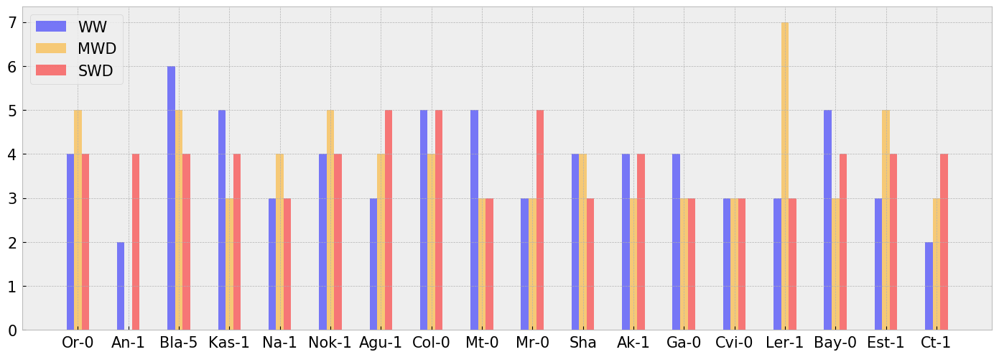

In [25]:
WW = []
MWD = []
SWD = []
for acc in accessions:
    WW.append(data_formated[(data_formated["Accession"] == acc) & (data_formated["Condition"] == "WW")].shape[0])
    MWD.append(data_formated[(data_formated["Accession"] == acc) & (data_formated["Condition"] == "MWD")].shape[0])
    SWD.append(data_formated[(data_formated["Accession"] == acc) & (data_formated["Condition"] == "SWD")].shape[0])

fig = plt.figure(figsize=(15,5))
ax = fig.add_axes([0.1, 0.1, 0.9, 0.9])
width = 0.15
ind = np.arange(len(WW))
WW_bar = ax.bar(ind, WW, width, color='blue', alpha=0.5, label="WW")
MWD_bar = ax.bar(ind+width, MWD, width, color='orange', alpha=0.5, label="MWD")
SWD_bar = ax.bar(ind+width*2, SWD, width, color='red', alpha=0.5, label="SWD")

ax.set_xticks(ind + 1 * width)
ax.set_xticklabels(accessions)
ax.legend(loc=2, prop={'size':15})

for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(15)
for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(15)

fig.savefig("abondance_plantes.png", bbox_inches = 'tight')

## Visualisation des données formatées

In [27]:
plt.style.use(['seaborn-poster', 'seaborn-white'])

plt.tight_layout()
Accessions = data_formated["Accession"].unique()
nbAccessions = len(Accessions)
fig, axes = plt.subplots(nbAccessions,3, figsize=(50,15*nbAccessions))

for i,acc in enumerate(Accessions):
    axes[i,1].text(0.2, 0.9, acc, size=70, ha="center", va="center", bbox=dict(boxstyle="round", ec="black",fc="white"), transform = axes[i,1].transAxes)
    for j,cond in enumerate(["WW", "MWD", "SWD"]):
        for idPot in set(data[(data["Accession"] == acc) & (data["Condition"] == cond)]["idPot"]):
            try:
                axes[i,j].plot(data_formated[data_formated["idPot"] == idPot]["TimeSerie"].iloc[0], marker='o', linewidth=7, markersize=15)
            except IndexError:
                pass
            axes[i,j].set_title(cond, fontsize=50)
            axes[i,j].set_xlabel('Jours',fontsize = 30)
            axes[i,j].set_ylabel('Surface projetée', fontsize = 30)
            for tick in axes[i,j].xaxis.get_major_ticks():
                tick.label.set_fontsize(30)
            for tick in axes[i,j].yaxis.get_major_ticks():
                tick.label.set_fontsize(30)

<Figure size 1280x880 with 0 Axes>

# Shapelet classification

## Transformation pandas dataFrame vers numpy array

In [68]:
###################################
# Choix du type de classification #
###################################
# WMS WMvS WvMS WS WM MS

#FORMAT_CLASSE = "WMS"
FORMAT_CLASSE = "WS"
#FORMAT_CLASSE = "WMvS"
#FORMAT_CLASSE = "WvMS"


# Z-Normalisation par série
NORMALISED = True

# Chemin d'enregistrement des résultats de la cross-validation
RESULT_PATH = "Resultats_cross_valid/"


# Permet d'indiquer les jours de début et de fin sur lesquels nous souhaitons appliquer la clasification (min=0 et max=25)
BEGIN_CLASSIF = 0
END_CLASSIF = 15

In [69]:
def standardClass(x):
    if x == "WW":
        return 0
    elif x == "MWD":
        return 1
    else:
        return 2

# Préparation des données
data2format = data_formated[["idPot", "Accession","Condition","TimeSerie"]].copy()
data2format = data2format.sample(frac=1)

dictChoices = {
    "WMS" : data2format["Condition"].apply(standardClass),
    "WMvS": data2format["Condition"].apply(lambda x: 1 if x == "SWD" else 0),
    "WvMS": data2format["Condition"].apply(lambda x: 0 if x == "WW" else 1),
    "WS": data2format["Condition"].drop(data2format[data2format["Condition"] == "MWD"].index).apply(lambda x: 0 if x == "WW" else 1),
    "WM": data2format["Condition"].drop(data2format[data2format["Condition"] == "SWD"].index).apply(lambda x: 0 if x == "WW" else 1)
}

clsOptions = {
        "WMS":{0:"WW", 1:"MWD", 2:"SWD"},
        "WMvS":{0:"WW/MWD",1:"SWD"},
        "WvMS":{0:"WW",1:"MWD/SWD"},
        "WSvM":{0:"WW/SWD",1:"MWD"},
        "WS":{0:"WW",1:"SWD"},
        "WM":{0:"WW",1:"MWD"},
        "MS":{0:"MWD",1:"SWD"}     
        }


dictOptions = {
        "WMS":["WW","MWD","SWD"],
        "WMvS":["WW/MWD","SWD"],
        "WvMS":["WW","MWD/SWD"],
        "WS":["WW","SWD"],
        "WM":["WW", "MWD"]
        }


data2format["Classe"] = dictChoices[FORMAT_CLASSE]
if FORMAT_CLASSE == "WS" or FORMAT_CLASSE == "WM":
    data2format.drop(data2format[data2format["Classe"].isna()].index, inplace=True)

# Ajuster la taille des séries
data2format["TimeSerie"] = data2format["TimeSerie"].apply(lambda x: x[BEGIN_CLASSIF:END_CLASSIF])

data_total = data2format[["TimeSerie", "Classe", "idPot"]].as_matrix()

/home/mindsound/.conda/envs/pipelineM2/lib/python3.6/site-packages/ipykernel_launcher.py:48: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.


## Classifiers de référence (KNN avec Euclidienne et DTW)

### KNN et la distance Euclidienne

Le jeu de données total est constitué de 137 séries
Les séries sont de taille 15
Exactitude : 0.84 (0.05)


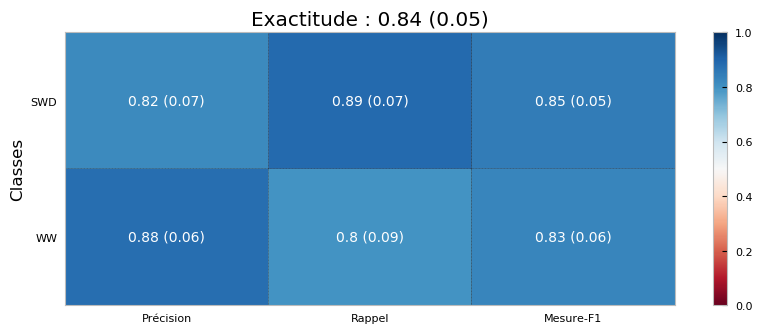

In [70]:
from sklearn import neighbors
from sklearn import metrics
import itertools

classNames = dictOptions[FORMAT_CLASSE]


#########################################
# Prepare datasets for cross validation #
#########################################
#X = data_total[:,0]
X = np.array(list(data2format["TimeSerie"].apply(list).values))

# Normalisation des données (standard)
X = StandardScaler().fit_transform(X)

print("Le jeu de données total est constitué de {} séries".format(len(X)))
print("Les séries sont de taille {}".format(len(X[0])))

#y = data_total[:,1]
y = np.array(list(data2format["Classe"].values))
sss = StratifiedShuffleSplit(n_splits=10, test_size=0.3, random_state=0)
########################################################################
classNames = dictOptions[FORMAT_CLASSE]

results = []
indexList = []
for loop, index in enumerate(sss.split(X,y)):
    train_index = index[0]
    test_index = index[1]
    
    knn = neighbors.KNeighborsClassifier()
    knn.fit(X[train_index], y[train_index])
    expected = y[test_index]
    predicted = knn.predict(X[test_index])
    results.append((expected, predicted))
    indexList.append((train_index, test_index))

# Récupère la liste des idPot utilisés pour les jeux d'entraînement/test dans chaque instance de validation
idPotIndex = []
for index in indexList:
    idPotIndex.append((data2format.iloc[index[0], 0].values, data2format.iloc[index[1], 0].values))
    

# Permet d'afficher le résultat résumé de la validation croisée
nameExp = FORMAT_CLASSE+"_KNN_with_Eucl_{}-{}".format(BEGIN_CLASSIF, END_CLASSIF)
displayClassificationReport(results, classNames, RESULT_PATH+nameExp+".png")

save_results = {"idPots":idPotIndex, "results":results}

with open(RESULT_PATH+nameExp+".pkl", "wb") as f:
    pickle.dump(save_results, f)

### KNN avec la distance DTW

Le jeu de données total est constitué de 137 séries
Les séries sont de taille 15
Exactitude : 0.89 (0.03)


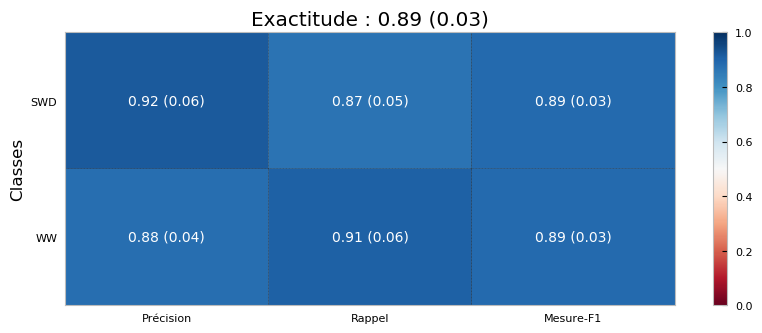

In [71]:
from __future__ import print_function
import numpy
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline

from tslearn.generators import random_walk_blobs
from tslearn.preprocessing import TimeSeriesScalerMinMax
from tslearn.neighbors import KNeighborsTimeSeriesClassifier, KNeighborsTimeSeries
from tslearn.piecewise import SymbolicAggregateApproximation
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from tslearn.metrics import dtw_path, SquaredEuclidean, SoftDTW


classNames = dictOptions[FORMAT_CLASSE]


#########################################
# Prepare datasets for cross validation #
#########################################
#X = data_total[:,0]
X = np.array(list(data2format["TimeSerie"].apply(list).values))
# Normalisation des données (standard)
X = TimeSeriesScalerMeanVariance(mu=0., std=1.).fit_transform(X)

print("Le jeu de données total est constitué de {} séries".format(len(X)))
print("Les séries sont de taille {}".format(len(X[0])))

y = np.array(list(data2format["Classe"].values))
sss = StratifiedShuffleSplit(n_splits=10, test_size=0.3, random_state=0)
########################################################################

results = []
indexList = []
for loop, index in enumerate(sss.split(X,y)):
    
    train_index = index[0]
    test_index = index[1]

    knn_clf = KNeighborsTimeSeriesClassifier(n_neighbors=5, metric='dtw')
    knn_clf.fit(X[train_index], y[train_index])
    expected = y[test_index]
    predicted = knn_clf.predict(X[test_index])
    results.append((expected, predicted))
    indexList.append((train_index, test_index))

# Récupère la liste des idPot utilisés pour les jeux d'entraînement/test dans chaque instance de validation
idPotIndex = []
for index in indexList:
    idPotIndex.append((data2format.iloc[index[0], 0].values, data2format.iloc[index[1], 0].values))
    
#displayResults(data2format, 6, idPotIndex, results)
#watchResults(results)

nameExp = FORMAT_CLASSE+"_KNN_with_DTW_{}-{}".format(BEGIN_CLASSIF, END_CLASSIF)
    
displayClassificationReport(results, classNames, RESULT_PATH+nameExp+".png")

save_results = {"idPots":idPotIndex, "results":results}

with open(RESULT_PATH+nameExp+".pkl", "wb") as f:
    pickle.dump(save_results, f)

## Shapelets exacts (Mueen)

### Configuration

In [72]:
# Configuration des noms de fichier
############################################
dataFileName = "data_train"
confusionMatrix = "confusionMatrix_"
resultShapeletSearch = "output"
dataSubGroup = "sousGroupes_"
dashFileName = "data_formated.pkl"
############################################

# Configuration des chemins
############################################
directory = "temp/"
pathDataFileName = directory+dataFileName
pathDataTree = pathDataFileName + "_tree"
pathConfusionMatrix = directory + confusionMatrix
pathResultShapeletSearch = directory+resultShapeletSearch
pathDataSubGroup = directory+dataSubGroup
pathDashFile = directory+dashFileName
############################################

pathDataTrain = directory+"train"
pathDataValid = directory+"valid"
pathDataTreeTrain = pathDataTrain + "_tree"

### Recherche shapelet Mueen (cross validation)

Le jeu de données total est constitué de 137 séries
Les séries sont de taille 15
Exactitude : 0.77 (0.06)


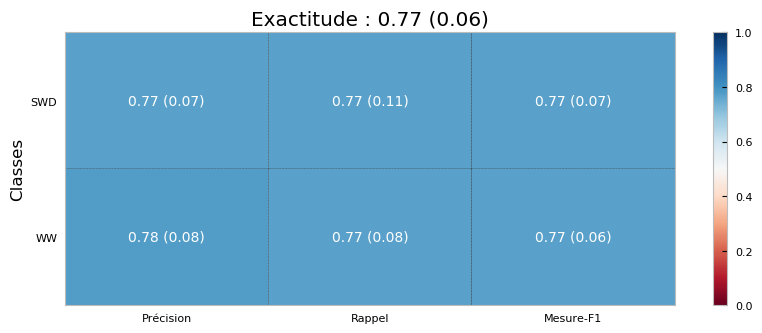

In [73]:
# Indiquer les tailles minimales et maximales ainsi que le pas des shapelets candidats
START = "3"
ENDSH = "5"
STEP = "1"

classNames = dictOptions[FORMAT_CLASSE]
TH_ENTROPY = "0.0"

# Supprimer les fichiers contenus dans le dossier temp/
for filename in os.listdir(directory[:-1]) :
    os.remove(directory + filename)

#########################################
# Prepare datasets for cross validation #
#########################################
X = list(data_total[:,0])
#X = StandardScaler().fit_transform(X)

y = list(data_total[:,1])
sss = StratifiedShuffleSplit(n_splits=10, test_size=0.3, random_state=1)
########################################################################

print("Le jeu de données total est constitué de {} séries".format(len(X)))
print("Les séries sont de taille {}".format(len(X[0])))

indiceLoop = {}
trees = []
groupDicts = []
groupMatrix = []

results = []
indexList = []
for loop, index in enumerate(sss.split(X,y)):
    
    train_index = index[0]
    test_index = index[1]
    indiceLoop[loop] = {"train_index":train_index, "test_index":test_index}
    
    indexList.append((train_index, test_index))

    # Création du fichier d'entrainement
    ############################################
    listLbl = []
    with open(pathDataTrain+str(loop), "w") as file:
        for i in train_index:
            listLbl.append(y[i])
            file.write("{}".format(y[i]))
            for elem in X[i]:
                file.write(" {}".format(elem))
            file.write("\n")
    ############################################  
    
    
    # Création du fichier de validation
    ############################################
    with open(pathDataValid+str(loop), "w") as file:
        for i in test_index:
            file.write("{}".format(y[i]))
            for elem in X[i]:
                file.write(" {}".format(elem))
            file.write("\n")
    ############################################
    
    # Création du modèle
    with open(pathResultShapeletSearch+str(loop), 'w') as file:
        res = subprocess.call(["Outils/main", pathDataTrain+str(loop), pathDataSubGroup+str(loop), str(len(train_index)), str(len(dictOptions[FORMAT_CLASSE])), TH_ENTROPY, ENDSH, START, STEP], stdout=file)
    

    # Classification du jeu de test
    error = open("temp/erreurs_{}.txt".format(loop), "w")
    with open(pathConfusionMatrix+str(loop), 'w') as file:
        res = subprocess.call(["Outils/classify_with_labels", pathDataValid+str(loop), pathDataTrain + "{}_tree".format(loop), str(len(test_index)), str(len(dictOptions[FORMAT_CLASSE]))], stdout=file, stderr=error)
        
    
    # Création du dictionnaire contenant les groupes à chaque neouds
    groupDict = {}
    with open(pathDataSubGroup+str(loop), 'r') as file:
        linesDictFile = file.readlines()
    linesDictFile = [x.strip() for x in linesDictFile]
    i=0
    groupDict[1] = train_index
    while i < len(linesDictFile):
        groupDict[int(linesDictFile[i+1])] = np.array([train_index[int(x)] for x in linesDictFile[i+2].split(",") if re.search("[0-9]+",x)])
        i+=3
    
    # Récupération des vrai Id de shapelets
    shapeletsDict = {}
    try:
        with open("temp/output"+str(loop), "r") as file:
            shapelet_file = file.readlines()
    except:
        print("Can't open shapelet file. ")
        
    shapelet_file = [x.strip() for x in shapelet_file]
        
    i=3
    while i < len(shapelet_file):
        idLine = re.search('Shpelet ID : ([0-9]+) , Start Position : ([0-9]+) , Shapelet Length : ([0-9]+)', shapelet_file[i])
        shapeletsDict[idLine.group(1)] = str(train_index[int(idLine.group(1))])
        i+=14
    
    # Création de l'arbre de décision
    currentTree = tree.DecisionTree(pathDataTrain + "{}_tree".format(loop), pathResultShapeletSearch+str(loop), groupDict, clsOptions[FORMAT_CLASSE], TH_ENTROPY, pd.Series(listLbl), shapeletsDict)
    
    # Sauvegarde des instances
    trees.append(currentTree)
    groupDicts.append(groupDict)
    
    
    # Récupération des prédictions
    with open(pathDataValid+str(loop)+"_labels", 'r') as f:
        predicted = [int(x.strip()) for x in f.readlines()]
        
    arrayY = np.array(y)
    results.append((arrayY[test_index], np.array(predicted)))

    
nameExp = FORMAT_CLASSE+"_mueen_{}-{}".format(BEGIN_CLASSIF, END_CLASSIF)
    
displayClassificationReport(results, classNames, RESULT_PATH+nameExp+".png")

save_results = {"idPots":idPotIndex, "results":results}

with open(RESULT_PATH+nameExp+".pkl", "wb") as f:
    pickle.dump(save_results, f)
    

## Shapelets Grabocka

Exactitude : 0.89 (0.04)


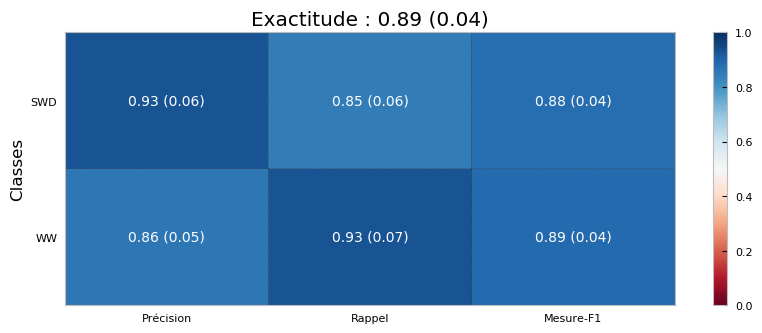

In [74]:
from keras.optimizers import Adagrad
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from tslearn.shapelets import ShapeletModel, grabocka_params_to_shapelet_size_dict
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import TimeSeriesSplit
from sklearn import preprocessing
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
import itertools

classNames = dictOptions[FORMAT_CLASSE]

#########################################
# Prepare datasets for cross validation #
#########################################
#X = data_total[:,0]
X = np.array(list(data2format["TimeSerie"].apply(list).values))
# Normalisation des données (standard)
X = TimeSeriesScalerMeanVariance(mu=0., std=1.).fit_transform(X)

#y = data_total[:,1]
y = np.array(list(data2format["Classe"].values))
sss = StratifiedShuffleSplit(n_splits=10, test_size=0.3, random_state=0)
########################################################################

# Détermination de la taille des shapelets
# shapelet_sizes = {taille_shapelets:nb_shapelets}
shapelet_sizes = grabocka_params_to_shapelet_size_dict(n_ts=len(X), ts_sz=len(X[0]), n_classes=len(dictOptions[FORMAT_CLASSE]),l=0.1,r=5)
#shapelet_sizes = {5:1}

# Paramétrage de l'estimateur
shp_clf = ShapeletModel(n_shapelets_per_size=shapelet_sizes,
                        optimizer=Adagrad(lr=.1),
                        weight_regularizer=.01,
                        max_iter=500,
                        verbose_level=0)


# Itération des cross-validation
results = []
indexList = []
for loop, index in enumerate(sss.split(X,y)):
    train_index = index[0]
    test_index = index[1]
    
    shp_clf.fit(X[train_index], y[train_index])
    predicted = shp_clf.predict(X[test_index])
    expected = y[test_index]
    results.append((expected, predicted))
    indexList.append((train_index, test_index))

#displayResults(data2format, 6, idPotIndex, results)
#watchResults(results)
    
nameExp = FORMAT_CLASSE+"_Grabocka_{}-{}".format(BEGIN_CLASSIF, END_CLASSIF)
    
displayClassificationReport(results, classNames, RESULT_PATH+nameExp+".png")

save_results = {"idPots":idPotIndex, "results":results}

with open(RESULT_PATH+nameExp+".pkl", "wb") as f:
    pickle.dump(save_results, f)

## Exploration de l'arbre de décision

L'exactitude est de 0.8029197080291971


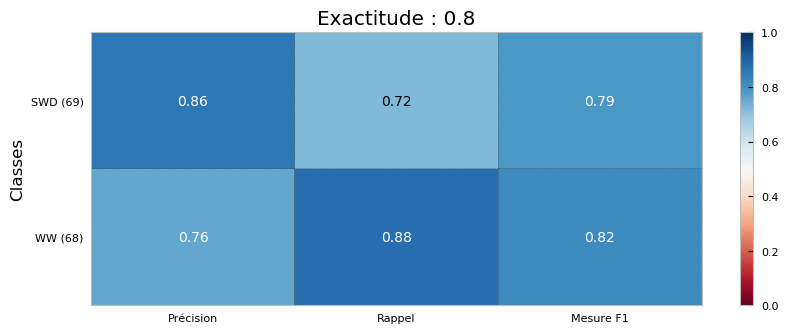

In [77]:
# Récupération de la totalité des données
X = list(data_total[:,0])

for i in range(len(X)):
    X[i] = X[i][:8]
y = list(data_total[:,1])

# Création du fichier texte de données
try:
    os.remove("data/data_shapelet_analysis_labels")
except:
    pass

with open("data/data_shapelet_analysis", "w") as file:
    for i in range(len(X)):
        file.write("{}".format(y[i]))
        for elem in X[i]:
            file.write(" {}".format(elem))
        file.write("\n")

# Lancement de la classification
res = subprocess.call(["Outils/classify_with_labels", "data/data_shapelet_analysis", "data/shapelet_analysing_tree", str(len(X)), str(2)])

# Lecture des prédiction
with open("data/data_shapelet_analysis_labels", 'r') as f:
    predicted = [int(x.strip()) for x in f.readlines()]

# Affichage des résultats
real = np.array(y)
real = real.astype(int)
print("L'exactitude est de {}".format(metrics.accuracy_score(real, predicted)))
plot_classification_report(metrics.classification_report(real, predicted, target_names=["WW","SWD"]), title="Exactitude : {}".format(round(metrics.accuracy_score(y, predicted), 2)))

<Figure size 640x440 with 0 Axes>

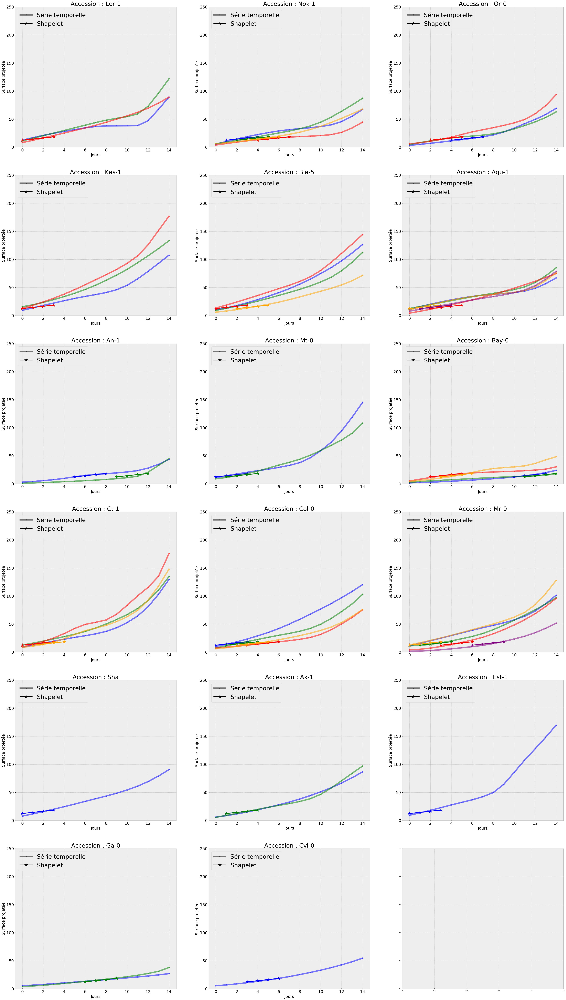

In [78]:
from scipy.spatial import distance

shapelet = [12.4081, 14.383, 16.4469, 18.4199]

# Definition fonction min pos
def minPos(ts, sh):
    minDist = float('Inf')
    minPos = None
    
    for i in range(len(ts)-len(sh)+1):
        if distance.euclidean(ts[i:i+len(sh)], sh) < minDist:
            minDist = distance.euclidean(ts[i:i+len(sh)], sh)
            minPos = i
    
    return minPos
        

# Récupération des idPots correctement prédits
WW_idPot = []
SWD_idPot = []
for i in range(len(predicted)):
    if y[i] == predicted[i]:
        if y[i] == 0.0:
            WW_idPot.append(data2format.iloc[i,0])
        else:
            SWD_idPot.append(data2format.iloc[i,0])

# Retrouver à quelles accessions appartiennent les idPot
accessionsDict = {}
for idP in SWD_idPot:
    try:
        accessionsDict[data2format[data2format["idPot"] == idP]["Accession"].values[0]].append(idP)
    except:
        accessionsDict[data2format[data2format["idPot"] == idP]["Accession"].values[0]] = [idP]

# Affichage
import matplotlib as mpl
import matplotlib.lines as mlines
mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use(['seaborn-paper', 'bmh'])

plt.tight_layout()
fig, axes = plt.subplots(6,3, figsize=(50,15*6))
axes = axes.flatten()

colors = ["blue", "green", "red", "orange", "purple", "black"]

subsequencesValues = []
beginningValues = []
for i ,acc in enumerate(accessionsDict.keys()):
    for j, idP in enumerate(accessionsDict[acc]):
        axes[i].plot(data2format[data2format["idPot"] == idP]["TimeSerie"].values[0], linewidth=7, marker='o', color=colors[j],  alpha=0.5)
        minP = minPos(np.array(data2format[data2format["idPot"] == idP]["TimeSerie"].values[0]), np.array(shapelet))
        l = list(range(minP, minP+len(shapelet)))
        
        # Récupérer les valeurs des sous-séquences
        subsequencesValues.append(data2format[data2format["idPot"] == idP]["TimeSerie"].values[0][l])
        beginningValues.append(data2format[data2format["idPot"] == idP]["TimeSerie"].values[0][:6])
        
        axes[i].plot(l, shapelet, marker="*", linewidth=4, markersize=20, color=colors[j])
    
    axes[i].set_title("Accession : {}".format(acc), fontsize=30)
    axes[i].set_xlabel('Jours',fontsize = 20)
    axes[i].set_ylabel('Surface projetée', fontsize = 20)
    axes[i].set_ylim([0,250])
    for tick in axes[i].xaxis.get_major_ticks():
        tick.label.set_fontsize(20)
    for tick in axes[i].yaxis.get_major_ticks():
        tick.label.set_fontsize(20)
        
    serieStyle = plt.Line2D((0,1),(0,0), color='black', marker='o', linewidth=7, alpha=0.5)
    shStyle = plt.Line2D((0,1),(0,0), marker="*", linewidth=4, markersize=20, color="black")
    
    axes[i].legend([serieStyle, shStyle], ["Série temporelle","Shapelet"], prop={"size":30}, loc=2)
    
#fig.savefig("Series_vs_Shapelet.png")

# Shapelet résumé
subsequencesValues = np.array(subsequencesValues)
resume_shapelet = subsequencesValues.mean(axis=0)
beginningValues = np.array(beginningValues)
resume_beginningValues = beginningValues.mean(axis=0)